### Este notebook es el mismo que el anterior 'gtg_en_mapamundi' pero acá los gráficos están hechos con la distancia calculada como distancia en la esfera (cambian las condiciones de contorno y así por ej Arg se puede conectar más fácil con Aus)

In [16]:
from math import radians, cos, sin, asin, sqrt
import math
import numpy as np
import networkx as nx
import pandas as pd
import os
from matplotlib import pyplot as plt

import enzope

datapath = '/home/lautaro/Workspace/ib/code/codedoc/realdata/redes/FAO'

In [3]:
prods = eval(open(os.path.join(datapath, "gprops-fixed.csv")).read())

## 09/10: Primer paso, dataset (nombres + coordenadas)

In [47]:
# Paso de latitud/longitud a coordenadas x, y en la proy. Mercator (en km)
def merc_from_arrays(lats, lons):
    # Voy a usar como unidad de longitud 1 km (10^3 m)
    r_major = 6378.137000
    x = r_major * np.radians(lons)
    scale = x/lons
    y = 180.0/np.pi * np.log(np.tan(np.pi/4.0 + lats * (np.pi/180.0)/2.0)) * scale
    return np.vstack((x, y)).T

def inverse_merc(pos):
    # Inversa en radianes
    r_major = 6378.137000
    long = pos[0]/r_major
    lat = 2 * np.arctan(np.exp(pos[1]/r_major)) - np.pi/2
    return [lat, long]

def great_circle(x, y):
    # The math module contains a function named
    # radians which converts from degrees to radians.
    u = inverse_merc(x)
    v = inverse_merc(y)
    
    lon1 = u[1]
    lon2 = v[1]
    lat1 = u[0]
    lat2 = v[0]

    # Haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2

    c = 2 * asin(sqrt(a))

    # Radius of earth in kilometers. Use 3956 for miles
    r = 6378.137000

    # Retorno distancia (en metros)
    return(c * r)

In [46]:
# Pruebita de las funciones de arriba
u = np.array(pos[0])
v = np.array(pos[1])
u_inv = inverse_merc(u)
v_inv = inverse_merc(v)
# u, merc_from_arrays(u_inv[0], u_inv[1])
u_inv = [180 * u_inv[0] / np.pi, 180 * u_inv[1] / np.pi]
u, merc_from_arrays(u_inv[0], u_inv[1])
sqrt(np.dot(u-v, u-v)), great_circle(u, v)

(10322.981872466351, 15389.096999561038)

In [5]:
# Voy a armar y guardar el dataset de nodos con los datos de latitud/longitud
coords = pd.read_csv(os.path.join(datapath, 'coordinate-countries-fixed.csv'))
coords = coords.rename(columns={'ISO 3166 Country Code': 'Code'})
coordinates = merc_from_arrays(coords['Latitude'], coords['Longitude'])
coords['x'] = coordinates[:, 0]
coords['y'] = coordinates[:, 1]

# Dropeo Hong Kong, Taiwan, China mainland y Macao
coords = coords[coords['Country'] != 'Hong Kong']
coords = coords[coords['Country'] != 'Taiwan']
coords = coords[coords['Country'] != 'China, mainland']
coords = coords[coords['Country'] != 'Macao']

# El codigo de Namibia se rompe
coords.loc[coords['Country'] == 'Namibia', 'Code'] = 'NAM'

nodes = pd.read_csv(os.path.join(datapath, 'nodes-fixed.csv'))
nodes = nodes.rename(columns={'# index': 'index', ' name': 'name'})
nodes = nodes.drop(columns=[' nodeLabel', ' _pos'])
# Drop row from nodes where 'Name' is 'unspecified'
nodes = nodes[nodes['name'] != 'Unspecified']
# Reemplazo '_' con ' ' para que matcheen mas paises
nodes['name'] = nodes['name'].str.replace('_', ' ')

# Merge DataFrames A and B based on matching country names
merged_nodes = pd.merge(coords, nodes, left_on='Country', right_on='name')

# Filter and sort the merged DataFrame
merged_nodes = merged_nodes[['index', 'Country', 'Code', 'Latitude', 'Longitude', 'x', 'y']].sort_values(by='index')
merged_nodes.reset_index(drop=True, inplace=True)

# merged_nodes.to_csv(os.path.join(datapath, 'nodes-merged.csv'), index=False)

In [6]:
def get_data(layer=1, info=False, edges=False):

    merged_nodes = pd.read_csv(os.path.join(datapath, 'nodes-merged.csv'))

    all_edges = pd.read_csv(os.path.join(datapath, 'edges.csv'))
    all_edges = all_edges.rename(columns={'# source': 'source', ' target': 'target', ' weight': 'weight', ' layer': 'layer'})

    unique_count = all_edges[['source', 'target']].values.flatten()
    unique_count = len(set(unique_count))

    # Filtro solo un layer (layer + 1 porque hice que gprops empiece en 0)
    one_layer_edges = all_edges[all_edges['layer'] == layer + 1]    # CUIDADO ACA: Entender porque es layer+1 (mirar gprops-fixed.csv)
    # Saco cuando source = target (que onda esto?)
    one_layer_edges = one_layer_edges[one_layer_edges['source'] != one_layer_edges['target']]
    # Filtro los paises que no estan en el dataframe (los que no tienen coordenadas)
    one_layer_edges = one_layer_edges[one_layer_edges['source'].isin(merged_nodes['index']) & one_layer_edges['target'].isin(merged_nodes['index'])]

    unique_count = one_layer_edges[['source', 'target']].values.flatten()
    unique_count = len(set(unique_count))

    if info:
        print(f"Layer {layer}: {prods[layer]}\nNumber of countries:", unique_count)

    # Ese palito es un 'or', en el editor se ve mal
    filtered_nodes = merged_nodes[merged_nodes['index'].isin(one_layer_edges['source']) | merged_nodes['index'].isin(one_layer_edges['target'])]

    G = nx.from_pandas_edgelist(one_layer_edges, source= 'source', target = 'target')

    pos = {node : [filtered_nodes.loc[filtered_nodes['index'] == node, 'x'].values[0], filtered_nodes.loc[filtered_nodes['index'] == node, 'y'].values[0]] for node in filtered_nodes['index']}
    
    codes = {node : filtered_nodes.loc[filtered_nodes['index'] == node, 'Code'].values[0] for node in filtered_nodes['index']}
        
    nx.set_node_attributes(G, pos, 'pos')
    nx.set_node_attributes(G, codes, 'code')

    if edges:
        return G, filtered_nodes, pos, codes, one_layer_edges
    else:
        return G, filtered_nodes, pos, codes

def draw(G, map=False, show_labels=True, ax=False):
    pos = nx.get_node_attributes(G, 'pos')
    codes = nx.get_node_attributes(G, 'code')
    pos_text = {i: [v[0], v[1] - 500] for i, v in pos.items()}
    # fig, ax = plt.subplots(figsize=(15,8))
    if ax == False:
        fig, ax = plt.subplots(dpi=300)
    if map:
        imgpath = os.path.join(os.getcwd(), 'mapa5a.png')
        image = plt.imread(imgpath)
        ax.imshow(image, extent=[-20000, 23000, -10000, 14500])
    if show_labels:
        nx.draw_networkx_labels(G, pos_text, codes, font_size=3)
    # if G has attribute size, use it as node_size, else use 6 as default
    size = [G.nodes[node].get('size', 6) for node in G.nodes()]

    colors = [G.nodes[node].get('color', 'royalblue') for node in G.nodes()]
    
    nx.draw(G, pos=pos, node_size=size, width=.05, ax=ax, node_color=colors)

### Grafico la red con grafo de fondo

Layer 2: Food_prep_nes
Number of countries: 191
Layer 7: Bananas
Number of countries: 139
Layer 9: Forage_products
Number of countries: 106
Layer 344: Soybeans
Number of countries: 130


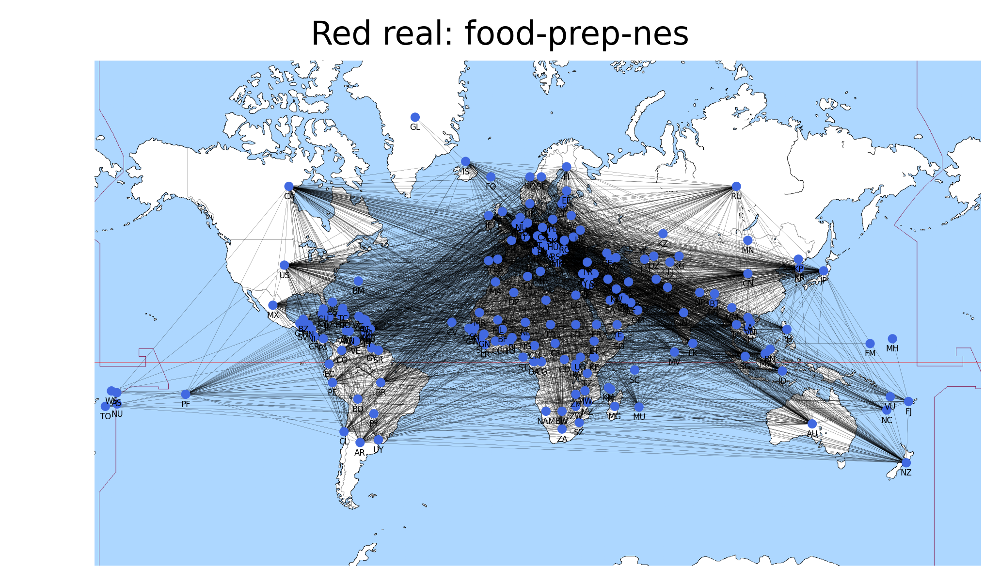

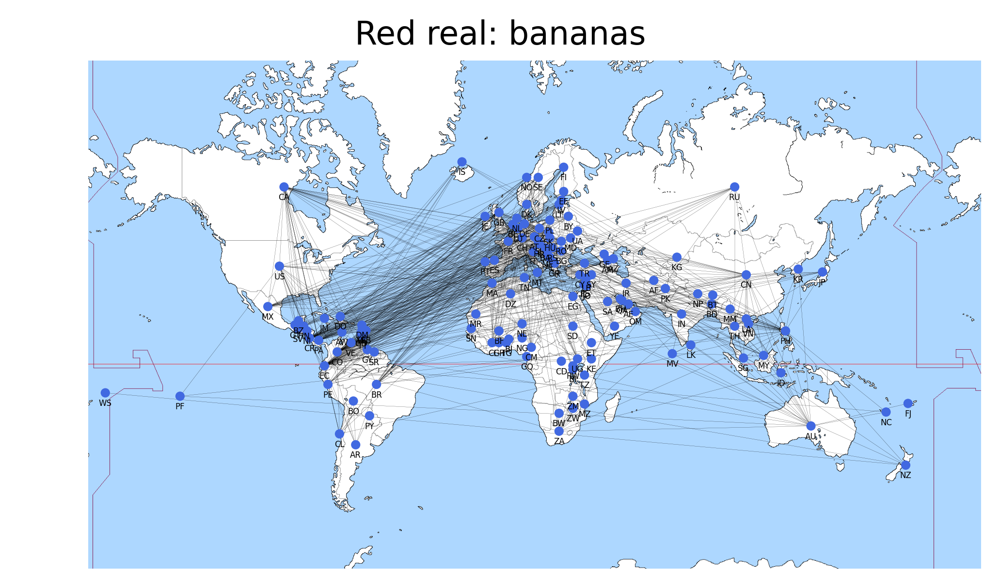

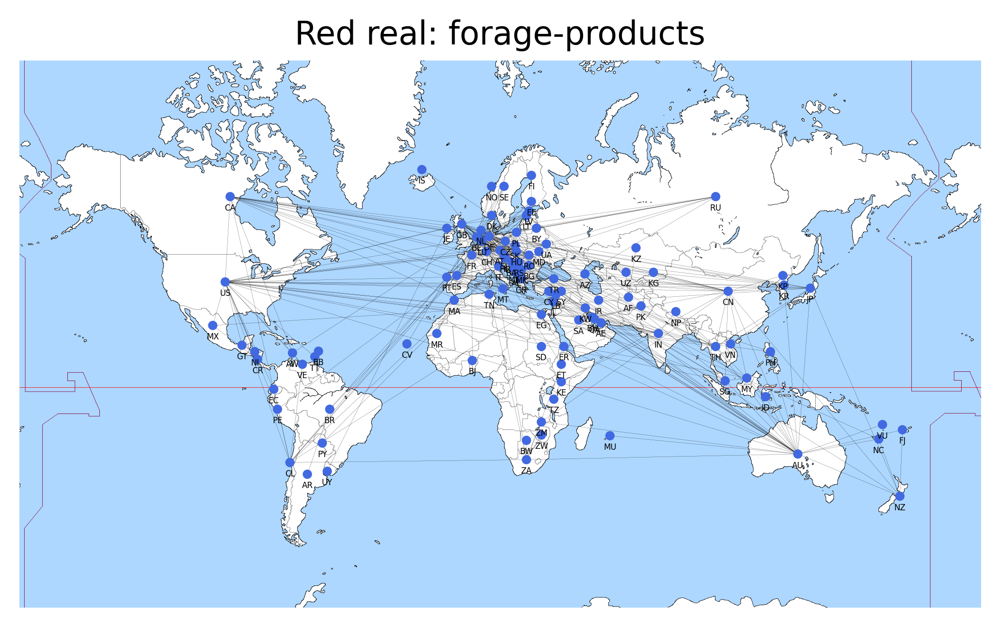

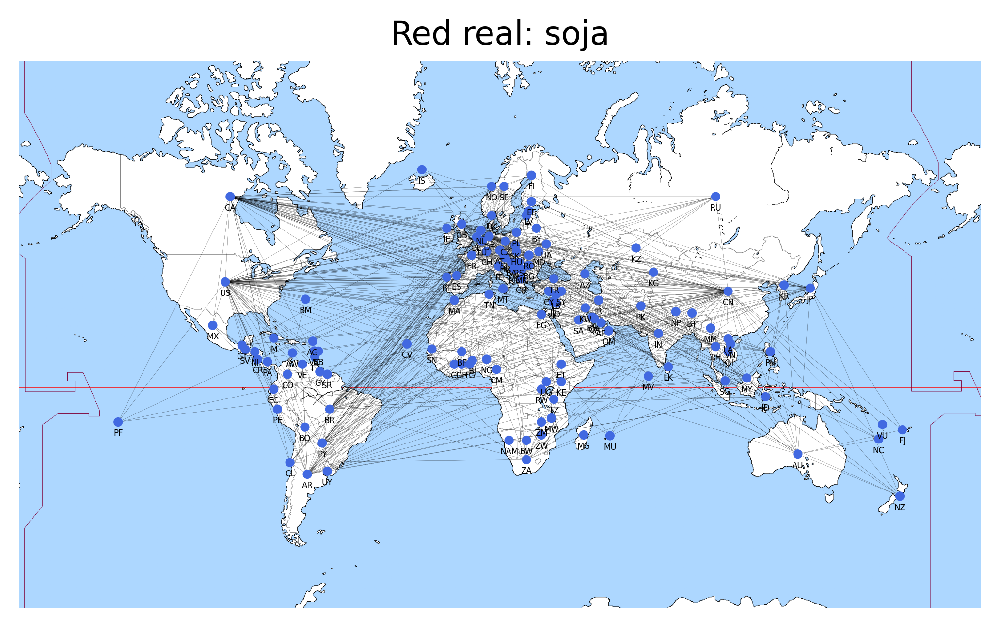

In [7]:
p = {2: 'food-prep-nes', 7: 'bananas', 9: 'forage-products', 344: 'soja'}
for i, prod in p.items():
    G, filtered_nodes, pos, codes = get_data(i, info=True)
    fig, ax = plt.subplots(dpi=400)
    ax.set_title('Red real: '+prod)
    draw(G, map=True, ax=ax)
    # 2: food prep nes, 7: bananas, 344: soja
    # plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', prod+'_real.svg'))

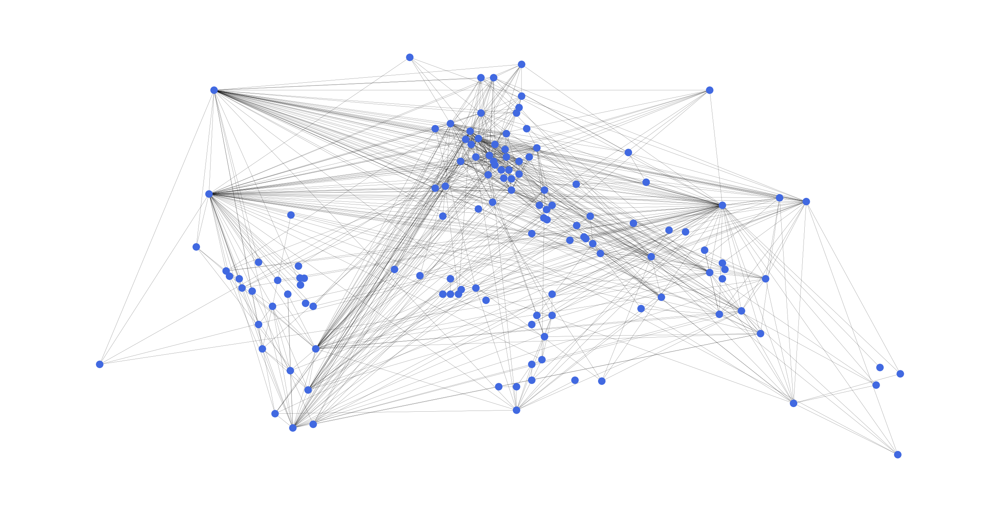

In [152]:
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(G, show_labels=False, ax=ax)
# plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'sojareal2.png'), dpi=250, bbox_inches='tight')

### Conectividad Soja

In [153]:
G, filtered_nodes, pos, codes = get_data(344)
print(nx.average_node_connectivity(G))

4.634943351222421


### Conectividad media por producto

In [154]:
connectivity = []
# for i in list(prods.keys()):
#     print(i)
#     G, filtered_nodes, pos, codes = get_data(i)
#     connectivity.append(nx.average_node_connectivity(G))
# print("Average product connectivity:", np.mean(connectivity))
# plt.hist(connectivity, bins=100)

### Usando datos de imp/exp

In [8]:
imports = pd.read_csv(os.path.join(datapath, 'imports_by_country.csv'), index_col=0)
exports = pd.read_csv(os.path.join(datapath, 'exports_by_country.csv'), index_col=0)

# Left join A and B on 'name' column
merged_df = exports.merge(imports, on='name', how='left')

# Fill missing 'imports' with 0
merged_df['imports (m usd)'].fillna(0, inplace=True)

# Calculate the sum of 'exports' and 'imports' for each row
merged_df['i + e (m usd)'] = merged_df['exports (m usd)'] + merged_df['imports (m usd)']

# Select the columns you want to keep in the resulting dataframe (A)
total_trade = merged_df[['name', 'i + e (m usd)']]
# Lo guardo
# total_trade.to_csv(os.path.join(datapath, 'total_trade_by_country.csv'), index=False)

### Posiciones reales -> gtg

In [9]:
def get_gtg(layer=1, theta=1e-3, resize='max', type='exports', join='add'):
    G, filtered_nodes, pos, codes = get_data(layer)

    exp_idx = [idx for idx in exports.index if idx in pos.keys()]
    imp_idx = [idx for idx in imports.index if idx in pos.keys()]
    act_idx = [idx for idx in total_trade.index if idx in pos.keys()]

    # Lo mismo con los pesos. Matcheo la key de pos (indice de pais) con la tabla exports (o imp o total)
    if type == 'exports':
        weights = {idx: exports['exports (m usd)'][idx] for idx in exp_idx}
        
    elif type == 'imports':
        weights = {idx: imports['imports (m usd)'][idx] for idx in imp_idx}
        
    elif type == 'total':
        weights = {idx : total_trade['i + e (m usd)'][idx] for idx in act_idx}
        # weights = dict(zip(total_trade.index, imports['i + e (m usd)']))

    if resize == 'max':
        scale = max(list(weights.values()))
        sizes = {k : v / (.01 * scale) for k, v in weights.items()}

    else:
        sizes = {k : v / resize for k, v in weights.items()}

    # Codigos de paises
    reindex_codes = {k: v for k, v in codes.items() if k in weights}

    # Me quedo solo con las posiciones de los nodos que aparecen en weights
    reduced_pos = {k: v for k, v in pos.items() if k in weights}
    reduced_pos = dict(enumerate(reduced_pos.values()))
    reindex_weights = dict(enumerate(weights.values()))
    reindex_sizes = dict(enumerate(sizes.values()))
    reindex_codes = dict(enumerate(reindex_codes.values()))

    gtg = enzope.geographical_threshold_graph_custom(len(reduced_pos.values()), theta=theta, metric=great_circle, pos=reduced_pos, weight=reindex_weights, join=join)
    nx.set_node_attributes(gtg, reindex_codes, 'code')
    nx.set_node_attributes(gtg, reindex_sizes, 'size')
    return gtg

In [10]:
G, _, _, _ = get_data(344)
gtg_add = get_gtg(344, theta=1.3e-3, type='exports')
gtg_mul = get_gtg(344, theta=2e-0, join='mul')
kreal = nx.connectivity.average_node_connectivity(G)
kadd = nx.connectivity.average_node_connectivity(gtg_add)
kmul = nx.connectivity.average_node_connectivity(gtg_mul)
print(f"Conectividad promedio de la red real: {kreal:.2f}")
print(f"Conectividad promedio de la red aditiva: {kadd:.2f}")
print(f"Conectividad promedio de la red multiplicativa: {kmul:.2f}")

KeyboardInterrupt: 

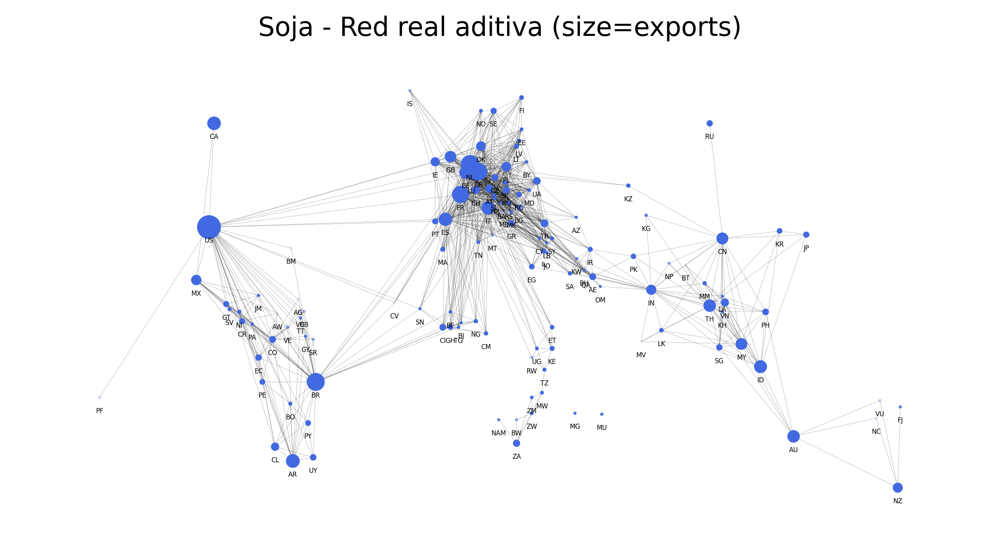

In [238]:
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg_add, show_labels=True, ax=ax)
ax.set_title('Soja - Red real aditiva (size=exports)')
# plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_add_pesos_exp.png'), dpi=500, bbox_inches='tight')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_add_pesos_exp_circ.svg'))

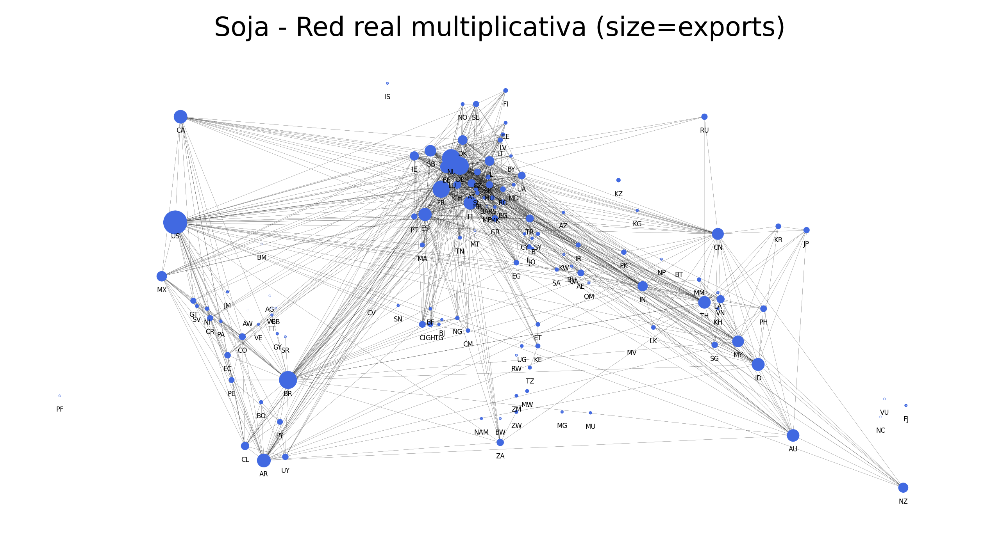

In [159]:
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
ax.set_title('Soja - Red real multiplicativa (size=exports)')
draw(gtg_mul, show_labels=True, ax=ax)
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_mul_pesos_exp_circ.svg'))

## 10/10: Redes gtg con peso sacado de los datos

### Empecemos con las 6 redes para todos los paises (E, I, E+I) (add y mul)

In [11]:
# sourcery skip: remove-dict-keys

nodes = pd.read_csv(os.path.join(datapath, 'nodes-merged.csv'))

exp_idx = [idx for idx in exports.index if idx in pos.keys()]
imp_idx = [idx for idx in imports.index if idx in pos.keys()]
act_idx = [idx for idx in total_trade.index if idx in pos.keys()]

pos = {node : [nodes.loc[nodes['index'] == node, 'x'].values[0], nodes.loc[nodes['index'] == node, 'y'].values[0]] for node in nodes['index']}
codes = {node : nodes.loc[nodes['index'] == node, 'Code'].values[0] for node in nodes['index']}

reindex_pos = dict(enumerate(pos.values()))
reindex_codes = dict(enumerate(codes.values()))

# exp_weights = dict(zip(exports.index, exports['exports (m usd)']))
exp_weights = {idx: exports['exports (m usd)'][idx] for idx in exp_idx}
imp_weights = {idx: imports['imports (m usd)'][idx] for idx in imp_idx}
act_weights = {idx: total_trade['i + e (m usd)'][idx] for idx in act_idx}

scale_exp = max(list(exp_weights.values()))
scale_imp = max(list(imp_weights.values()))
scale_act = max(list(act_weights.values()))
exp_sizes = {k : v / (.01 * scale_exp) for k, v in exp_weights.items()}
imp_sizes = {k : v / (.01 * scale_imp) for k, v in imp_weights.items()}
act_sizes = {k : v / (.01 * scale_act) for k, v in act_weights.items()}

exp_pos = {k: v for k, v in pos.items() if k in exp_weights}
imp_pos = {k: v for k, v in pos.items() if k in imp_weights}
act_pos = {k: v for k, v in pos.items() if k in act_weights}

exp_codes = {k: v for k, v in codes.items() if k in exp_weights}
imp_codes = {k: v for k, v in codes.items() if k in imp_weights}
act_codes = {k: v for k, v in codes.items() if k in act_weights}

# Esto es horrible pero reindexo los diccionarios para que los entienda el grafo (tienen que ser 1, 2, 3 sin saltearse)
exp_weights = dict(enumerate(exp_weights.values()))
exp_sizes = dict(enumerate(exp_sizes.values()))
exp_pos = dict(enumerate(exp_pos.values()))
exp_codes = dict(enumerate(exp_codes.values()))
imp_weights = dict(enumerate(imp_weights.values()))
imp_sizes = dict(enumerate(imp_sizes.values()))
imp_pos = dict(enumerate(imp_pos.values()))
imp_codes = dict(enumerate(imp_codes.values()))
act_weights = dict(enumerate(act_weights.values()))
act_sizes = dict(enumerate(act_sizes.values()))
act_pos = dict(enumerate(act_pos.values()))
act_codes = dict(enumerate(act_codes.values()))

In [51]:
theta = 1.4e-3

# Exp add
gtg1 = enzope.geographical_threshold_graph_custom(len(exp_pos.values()), theta=theta, metric=great_circle, pos=exp_pos, weight=exp_weights, join='add')
nx.set_node_attributes(gtg1, exp_codes, 'code')
nx.set_node_attributes(gtg1, exp_sizes, 'size')

# Imp add
gtg2 = enzope.geographical_threshold_graph_custom(len(imp_pos.values()), theta=1.1*theta, metric=great_circle, pos=imp_pos, weight=imp_weights, join='add')
nx.set_node_attributes(gtg2, imp_codes, 'code')
nx.set_node_attributes(gtg2, imp_sizes, 'size')

# Act add
gtg3 = enzope.geographical_threshold_graph_custom(len(act_pos.values()), theta=1.8*theta, metric=great_circle, pos=act_pos, weight=act_weights, join='add')
nx.set_node_attributes(gtg3, act_codes, 'code')
nx.set_node_attributes(gtg3, act_sizes, 'size')

# Exp mul
gtg4 = enzope.geographical_threshold_graph_custom(len(exp_pos.values()), theta=1300*theta, metric=great_circle, pos=exp_pos, weight=exp_weights, join='mul')
nx.set_node_attributes(gtg4, reindex_codes, 'code')
nx.set_node_attributes(gtg4, exp_sizes, 'size')

# Imp mul
gtg5 = enzope.geographical_threshold_graph_custom(len(imp_pos.values()), theta=1800*theta, metric=great_circle, pos=imp_pos, weight=imp_weights, join='mul')
nx.set_node_attributes(gtg5, reindex_codes, 'code')
nx.set_node_attributes(gtg5, imp_sizes, 'size')

# Act mul
gtg6 = enzope.geographical_threshold_graph_custom(len(act_pos.values()), theta=5000*theta, metric=great_circle, pos=act_pos, weight=act_weights, join='mul')
nx.set_node_attributes(gtg6, reindex_codes, 'code')
nx.set_node_attributes(gtg6, act_sizes, 'size')

# Code that prints the connectivity of all gtgs
for i, gtg in enumerate([gtg1, gtg2, gtg3, gtg4, gtg5, gtg6]):
    k = nx.connectivity.average_node_connectivity(gtg)
    print(f"i = {i}, Conectividad promedio: {k:.2f}")


i = 0, Conectividad promedio: 7.80
i = 1, Conectividad promedio: 8.25
i = 2, Conectividad promedio: 9.14
i = 3, Conectividad promedio: 7.27
i = 4, Conectividad promedio: 8.46
i = 5, Conectividad promedio: 9.28


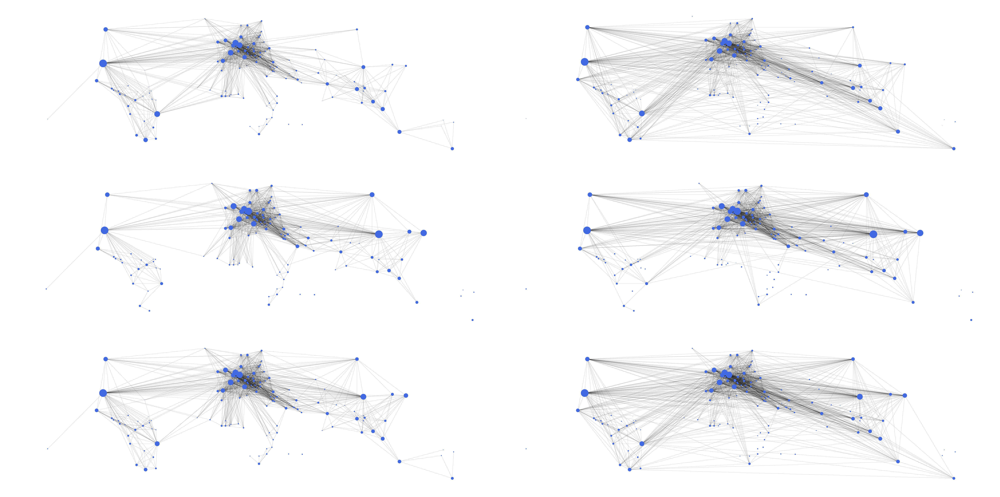

In [52]:
graphs = [gtg1, gtg2, gtg3, gtg4, gtg5, gtg6]  

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(3, 2, figsize=[20, 10], dpi=300)

# Iterate through the graphs and corresponding subplot axes
for i, graph in enumerate(graphs):
    row = i % 3  # Calculate the row index (0 or 1)
    col = i // 3   # Calculate the column index (0, 1, or 2)
    ax = axs[row, col]  # Get the appropriate subplot axis

    # Call your draw function for the current graph and subplot axis
    draw(graph, show_labels=False, ax=ax)

# Adjust the layout to prevent overlap
plt.tight_layout()

# Display the plot
plt.show()
# plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_6_gtgs_pesos_totales.png'), dpi=200)
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_6_gtgs_pesos_totales_circ.svg'))


Text(0.5, 1.0, 'Soja gtg multiplicativa - pesos act')

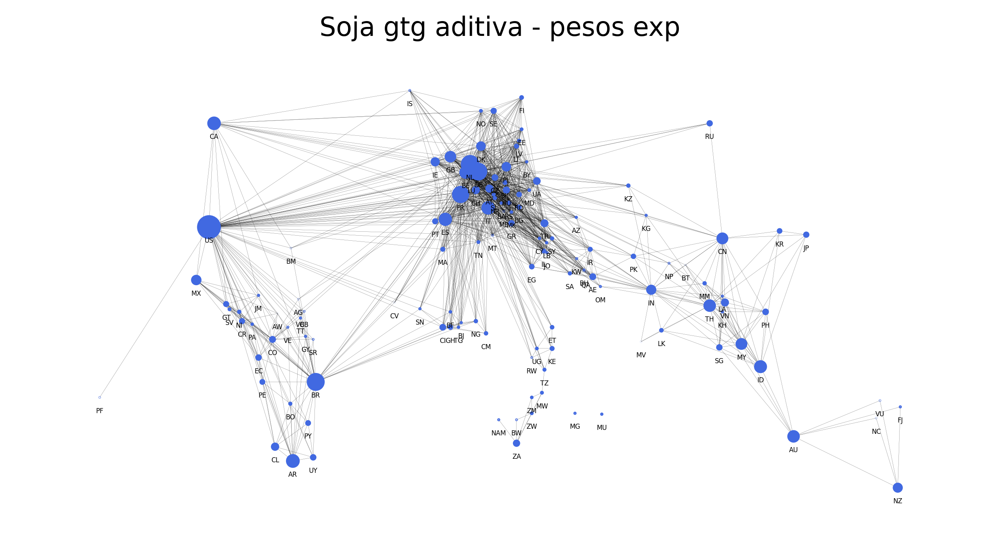

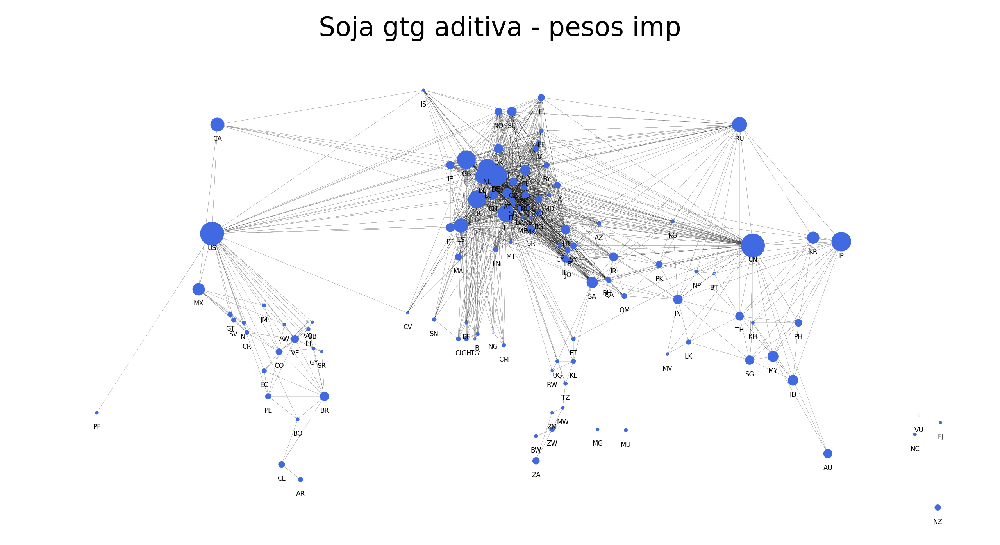

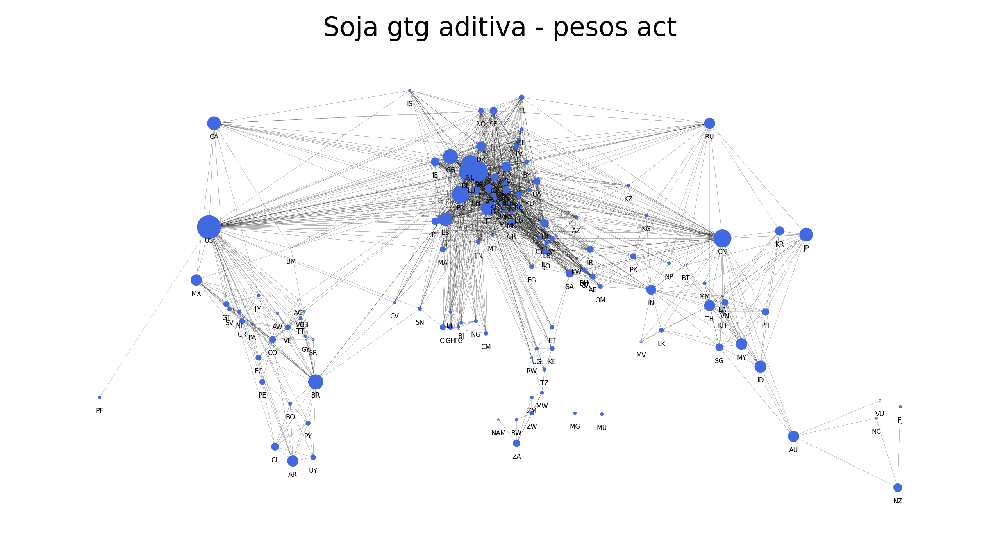

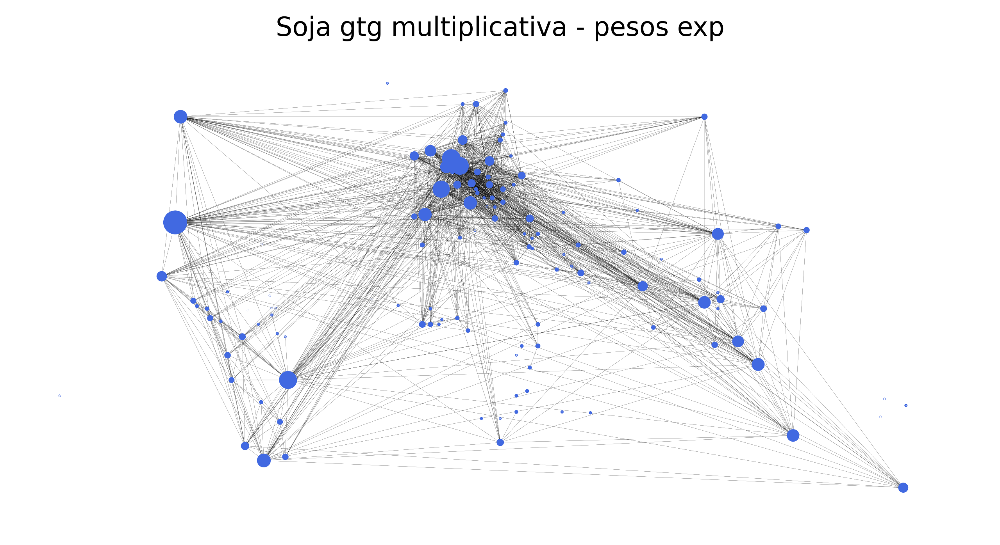

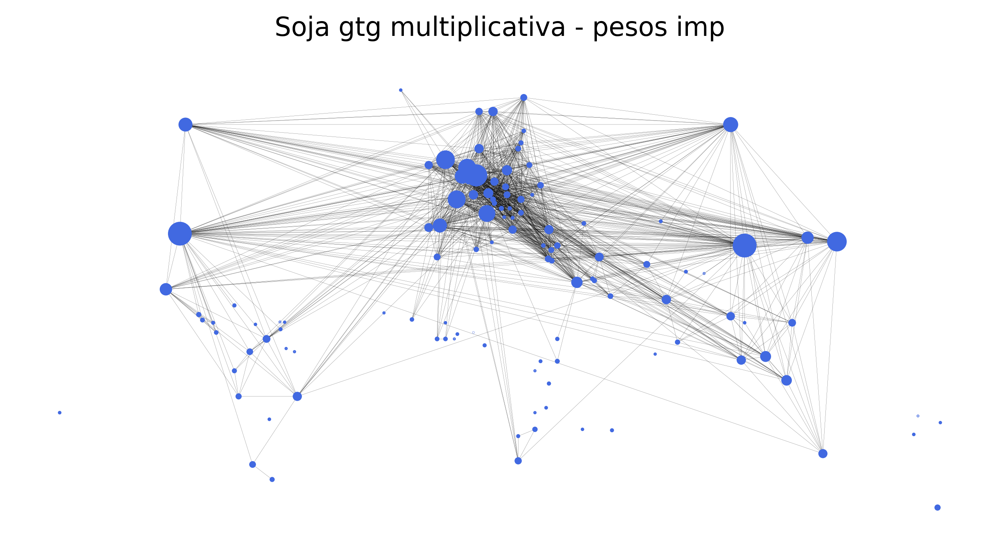

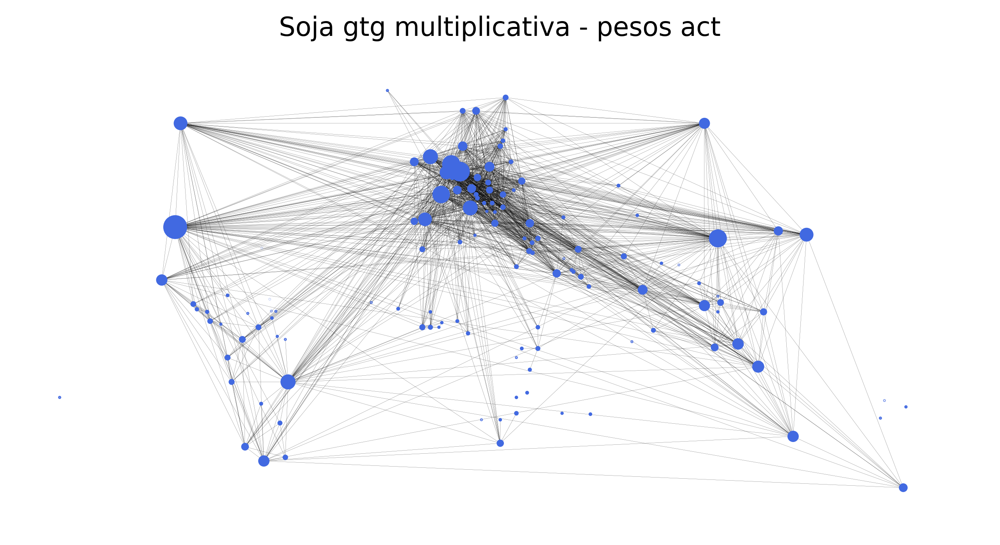

In [53]:
# Exportaciones totales add
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg1, ax=ax, show_labels=True)
ax.set_title('Soja gtg aditiva - pesos exp')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_add_exp_circ.svg'))

# Importaciones totales add
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg2, ax=ax, show_labels=True)
ax.set_title('Soja gtg aditiva - pesos imp')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_add_imp_circ.svg'))

# Actividad total add
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg3, ax=ax, show_labels=True)
ax.set_title('Soja gtg aditiva - pesos act')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_add_act_circ.svg'))

# Exportaciones totales mul
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg4, ax=ax, show_labels=False)
ax.set_title('Soja gtg multiplicativa - pesos exp')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_mul_exp_circ.svg'))

# Importaciones totales mul
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg5, ax=ax, show_labels=False)
ax.set_title('Soja gtg multiplicativa - pesos imp')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_mul_imp_circ.svg'))

fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg6, ax=ax, show_labels=False)
ax.set_title('Soja gtg multiplicativa - pesos act')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_mul_act_circ.svg'))

## 23/10: Cosas pendientes

### Mapa con tamaño de nodos

Layer 344: Soybeans
Number of countries: 130


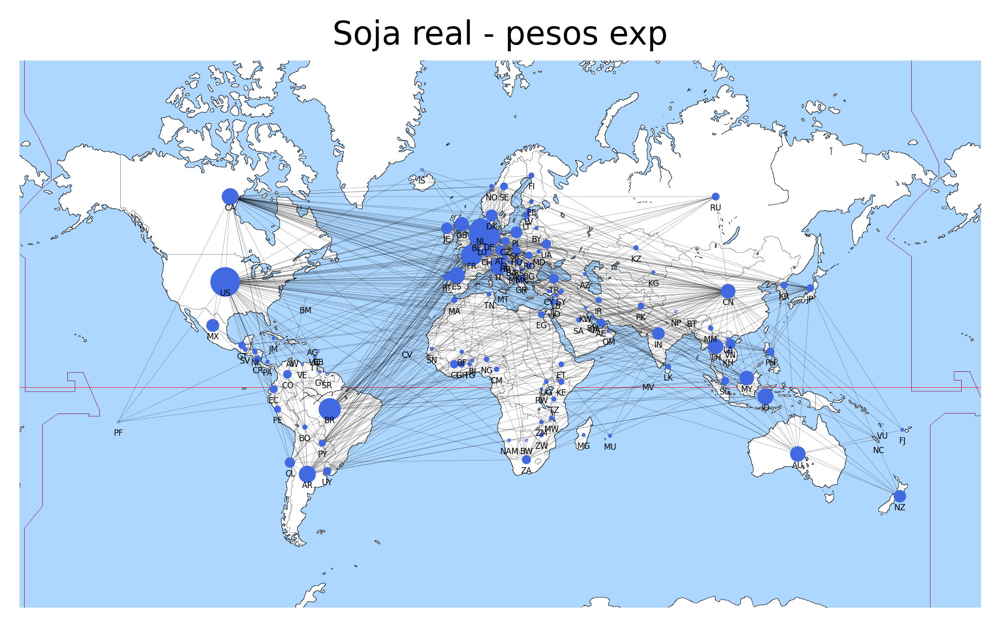

In [164]:
G, filtered_nodes, pos, codes = get_data(344, info=True)

exp_idx = [idx for idx in exports.index if idx in pos.keys()]

reindex_codes = dict(enumerate(codes.values()))

# exp_weights = dict(zip(exports.index, exports['exports (m usd)']))
exp_w = {idx: exports['exports (m usd)'][idx] for idx in exp_idx}

scale_exp = max(list(exp_w.values()))
exp_s = {k : v / (.01 * scale_exp) for k, v in exp_w.items()}

nx.set_node_attributes(G, exp_s, 'size')

fig, ax = plt.subplots(dpi=400)
ax.set_title('Soja real - pesos exp')
draw(G, map=True, ax=ax)
# 2: food prep nes, 7: bananas, 9: forege products, 344: soja
# plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_real_pesos_exp_total.svg'))

### Plot con pesos de soja

In [165]:
# Pesos de solo la soja
G, filtered_nodes, pos, codes, one_layer_edges = get_data(344, info=True, edges=True)

Layer 344: Soybeans
Number of countries: 130


In [166]:
soja_df = pd.read_csv(os.path.join(datapath, 'net_trade_by_country_soja.csv'))
soja_df.set_index('index', inplace=True)

soja_df

,name,net_trade (m usd)
index,,
1,Australia,1.625
2,Austria,-24.188
3,Belgium,-190.573
4,Brazil,12625.681
5,Canada,1108.436
...,...,...
177,Saint Vincent and the Grenadines,-0.574
181,French Polynesia,-0.022
186,Senegal,-0.006


In [167]:
theta = .0001
soja_idx = [idx for idx in soja_df.index if idx in pos.keys()]

# exp_pos = {k: v for k, v in pos.items() if k in exp_weights}
soja_codes = {k: codes[k] for k in soja_idx}
# soja_w is the value of 'net trade (m usd)' for each idx that appears in the 'index' column of soja_df
soja_w = {idx: soja_df['net_trade (m usd)'][idx] for idx in soja_idx}
soja_w = {k: abs(v) for k, v in soja_w.items()}
soja_pos = {k: pos[k] for k in soja_idx}
soja_scale = max(list(soja_w.values()))
soja_size = {k : v / (.01 * soja_scale) for k, v in soja_w.items()}
# Lo hago asi porque sino no funciona. Busco color nomas
asd = [w for w in list(soja_df['net_trade (m usd)'])]
soja_color = ['red' if w < 0 else 'green' for w in asd]

soja_w = dict(enumerate(soja_w.values()))
soja_size = dict(enumerate(soja_size.values()))
soja_pos = dict(enumerate(soja_pos.values()))
soja_codes = dict(enumerate(soja_codes.values()))
soja_color = dict(enumerate(soja_color))

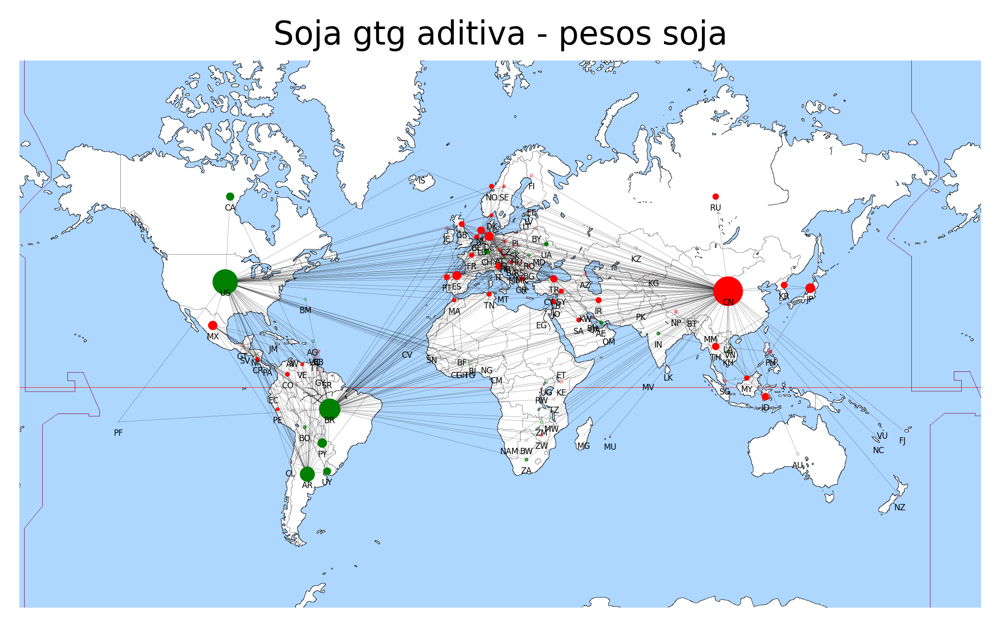

In [168]:
gtg_soja = enzope.geographical_threshold_graph_custom(len(soja_pos.values()), theta=theta, metric=great_circle, pos=soja_pos, weight=soja_w, join='add')
nx.set_node_attributes(gtg_soja, soja_size, 'size')
nx.set_node_attributes(gtg_soja, soja_codes, 'code')
nx.set_node_attributes(gtg_soja, soja_color, 'color')

fig, ax = plt.subplots(dpi=400)
ax.set_title('Soja gtg aditiva - pesos soja')
draw(gtg_soja, map=True, ax=ax)
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_add_pesos_reales_circ.svg'))

### Soja red real con pesos de soja (suma de links de soja pesados por volumen)

### ATENCION: Este gráfico esta mal (debería tener los mismos links que el de arriba, hay que ver como arreglarlo)

In [214]:
G, filtered_nodes, pos, codes, one_layer_edges = get_data(344, info=True, edges=True)

mapping = {}
for i, j in zip(sorted(list(G.nodes)), soja_pos.keys()):
    mapping[i] = j

one_layer_edges['source'] = one_layer_edges['source'].map(mapping)
one_layer_edges['target'] = one_layer_edges['target'].map(mapping)

G_ord = nx.from_pandas_edgelist(one_layer_edges, source= 'source', target = 'target')



Layer 344: Soybeans
Number of countries: 130
[1, 2, 3, 4, 5, 6, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 33, 34, 35, 36, 38, 39, 41, 42, 43, 44, 46, 48, 50, 51, 54, 57, 59, 61, 62, 66, 67, 68, 70, 72, 73, 74, 75, 77, 78, 80, 81, 82, 83, 85, 86, 87, 88, 91, 94, 95, 97, 104, 106, 107, 108, 109, 112, 113, 114, 118, 120, 123, 129, 131, 136, 138, 146, 149, 152, 153, 169, 171, 172, 179]


Layer 344: Soybeans
Number of countries: 130
130


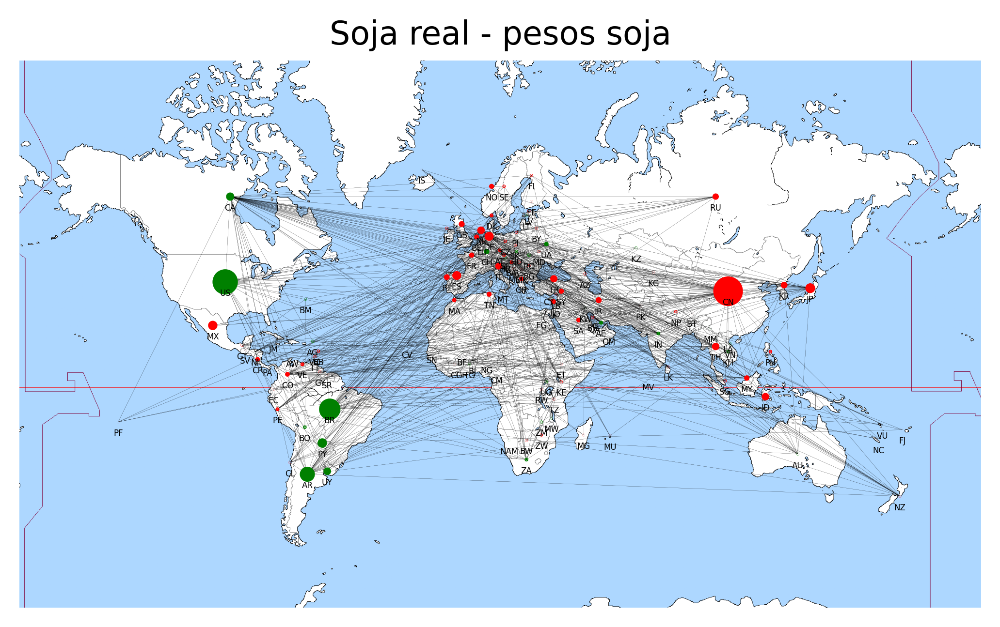

In [200]:
G, filtered_nodes, pos, codes, one_layer_edges = get_data(344, info=True, edges=True)

mapping = {}
for i, j in zip(sorted(list(G.nodes)), soja_pos.keys()):
    mapping[i] = j

one_layer_edges['source'] = one_layer_edges['source'].map(mapping)
one_layer_edges['target'] = one_layer_edges['target'].map(mapping)

G_ord = nx.from_pandas_edgelist(one_layer_edges, source= 'source', target = 'target')

# G_ord = nx.relabel_nodes(G, mapping)

nx.set_node_attributes(G_ord, soja_pos, 'pos')
nx.set_node_attributes(G_ord, soja_codes, 'code')
nx.set_node_attributes(G_ord, soja_size, 'size')
nx.set_node_attributes(G_ord, soja_color, 'color')

fig, ax = plt.subplots(dpi=400)
ax.set_title('Soja real - pesos soja')
draw(G_ord, map=True, ax=ax)
# 2: food prep nes, 7: bananas, 9: forege products, 344: soja
# plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_real_pesos_soja.svg'))

### Usando 1/r

In [222]:
theta = 7.5

def p_dist(r):
    return r ** -1

# Exp add
gtg1 = enzope.geographical_threshold_graph_custom(len(exp_pos.values()), p_dist=p_dist, theta=theta, metric=great_circle, pos=exp_pos, weight=exp_weights, join='add')
nx.set_node_attributes(gtg1, exp_codes, 'code')
nx.set_node_attributes(gtg1, exp_sizes, 'size')

# Imp add
gtg2 = enzope.geographical_threshold_graph_custom(len(imp_pos.values()), p_dist=p_dist, theta=theta, metric=great_circle, pos=imp_pos, weight=imp_weights, join='add')
nx.set_node_attributes(gtg2, imp_codes, 'code')
nx.set_node_attributes(gtg2, imp_sizes, 'size')

# Act add
gtg3 = enzope.geographical_threshold_graph_custom(len(act_pos.values()), p_dist=p_dist, theta=1.8*theta, metric=great_circle, pos=act_pos, weight=act_weights, join='add')
nx.set_node_attributes(gtg3, act_codes, 'code')
nx.set_node_attributes(gtg3, act_sizes, 'size')

# Exp mul
gtg4 = enzope.geographical_threshold_graph_custom(len(exp_pos.values()), p_dist=p_dist, theta=1600*theta, metric=great_circle, pos=exp_pos, weight=exp_weights, join='mul')
nx.set_node_attributes(gtg4, reindex_codes, 'code')
nx.set_node_attributes(gtg4, exp_sizes, 'size')

# Imp mul
gtg5 = enzope.geographical_threshold_graph_custom(len(imp_pos.values()), p_dist=p_dist, theta=2100*theta, metric=great_circle, pos=imp_pos, weight=imp_weights, join='mul')
nx.set_node_attributes(gtg5, reindex_codes, 'code')
nx.set_node_attributes(gtg5, imp_sizes, 'size')

# Act mul
gtg6 = enzope.geographical_threshold_graph_custom(len(act_pos.values()), p_dist=p_dist, theta=6000*theta, metric=great_circle, pos=act_pos, weight=act_weights, join='mul')
nx.set_node_attributes(gtg6, reindex_codes, 'code')
nx.set_node_attributes(gtg6, act_sizes, 'size')

# Code that prints the connectivity of all gtgs
for i, gtg in enumerate([gtg1, gtg2, gtg3, gtg4, gtg5, gtg6]):
    k = nx.connectivity.average_node_connectivity(gtg)
    print(f"i = {i}, Conectividad promedio: {k:.2f}")


i = 0, Conectividad promedio: 4.45
i = 1, Conectividad promedio: 4.54
i = 2, Conectividad promedio: 5.08
i = 3, Conectividad promedio: 4.46
i = 4, Conectividad promedio: 4.63
i = 5, Conectividad promedio: 5.44


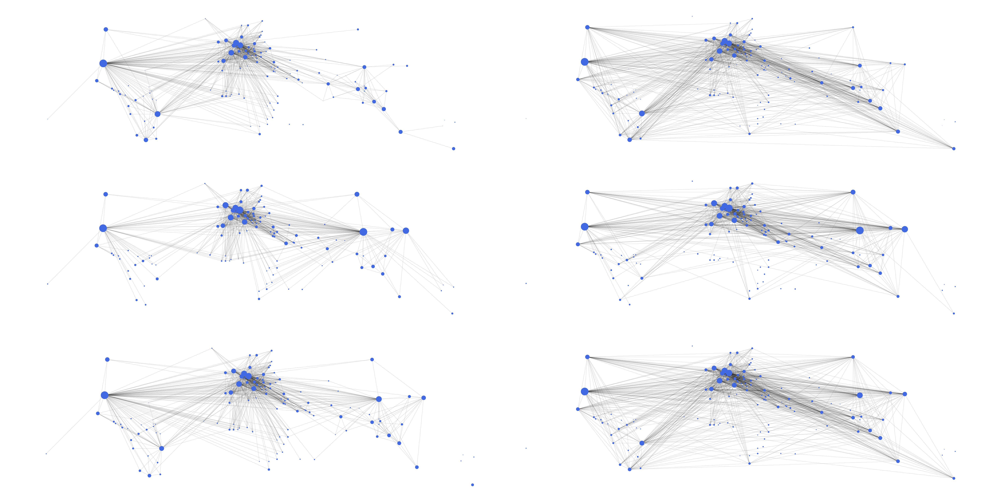

In [223]:
graphs = [gtg1, gtg2, gtg3, gtg4, gtg5, gtg6]  

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(3, 2, figsize=[20, 10], dpi=300)

# Iterate through the graphs and corresponding subplot axes
for i, graph in enumerate(graphs):
    row = i % 3  # Calculate the row index (0 or 1)
    col = i // 3   # Calculate the column index (0, 1, or 2)
    ax = axs[row, col]  # Get the appropriate subplot axis

    # Call your draw function for the current graph and subplot axis
    draw(graph, show_labels=False, ax=ax)

# Adjust the layout to prevent overlap
plt.tight_layout()

plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_6_gtgs_pesos_totales_-1_circ.svg'))

# Display the plot
plt.show()


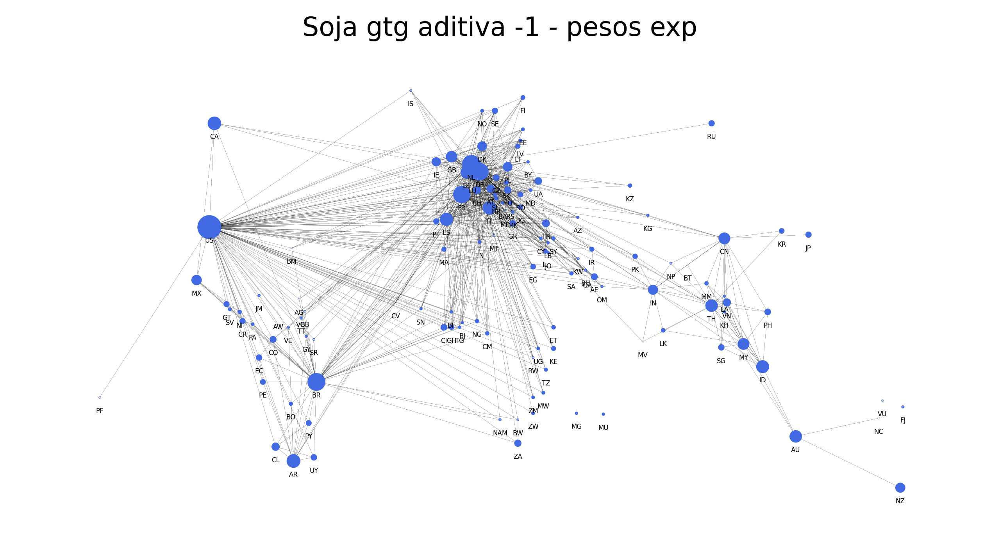

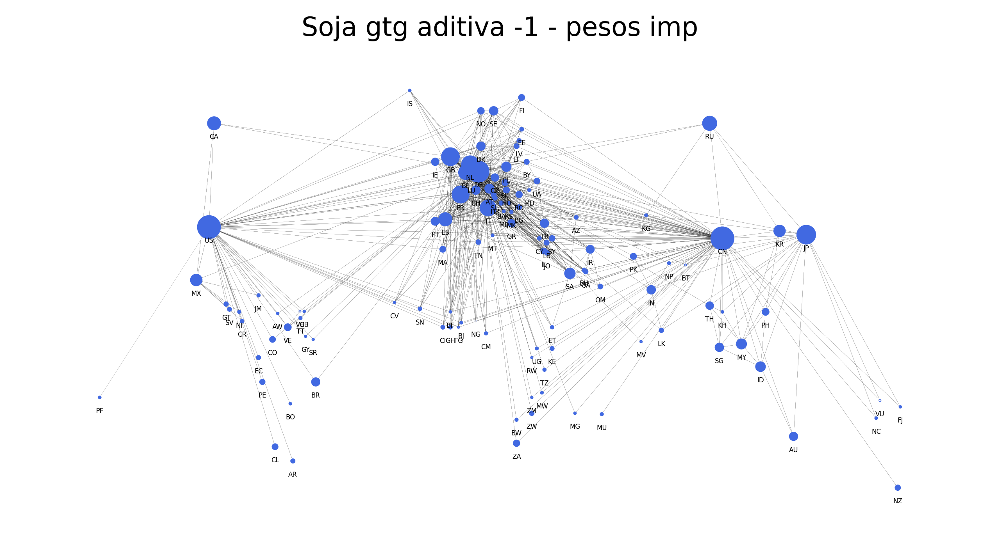

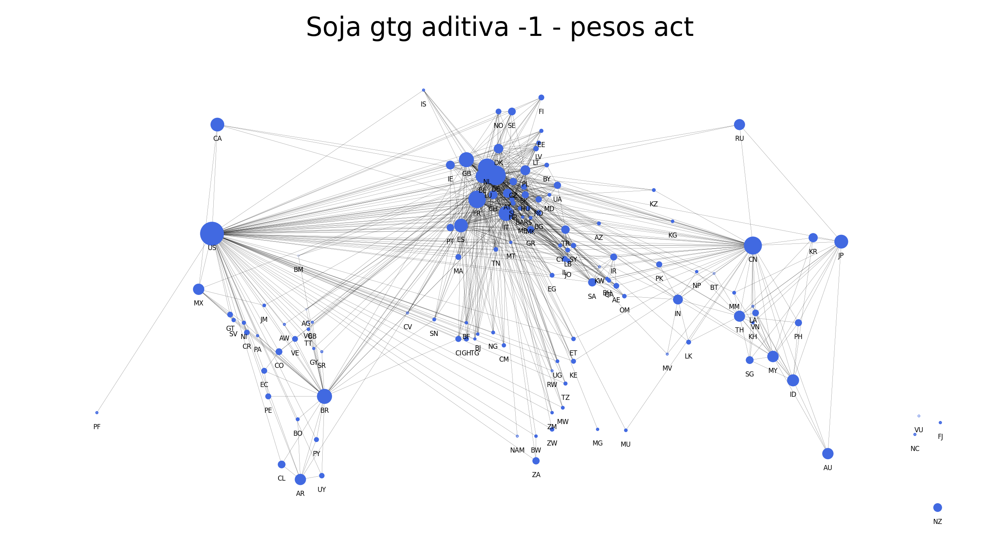

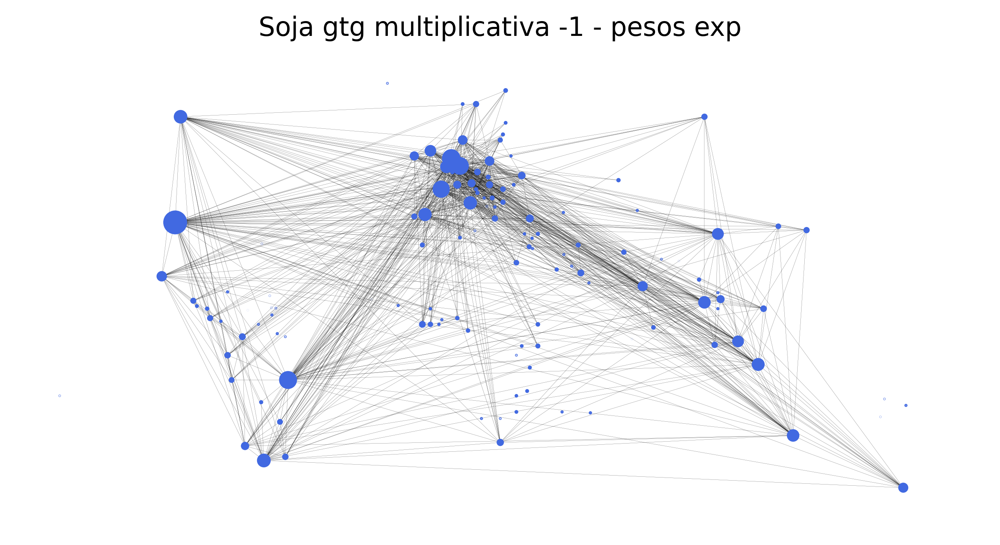

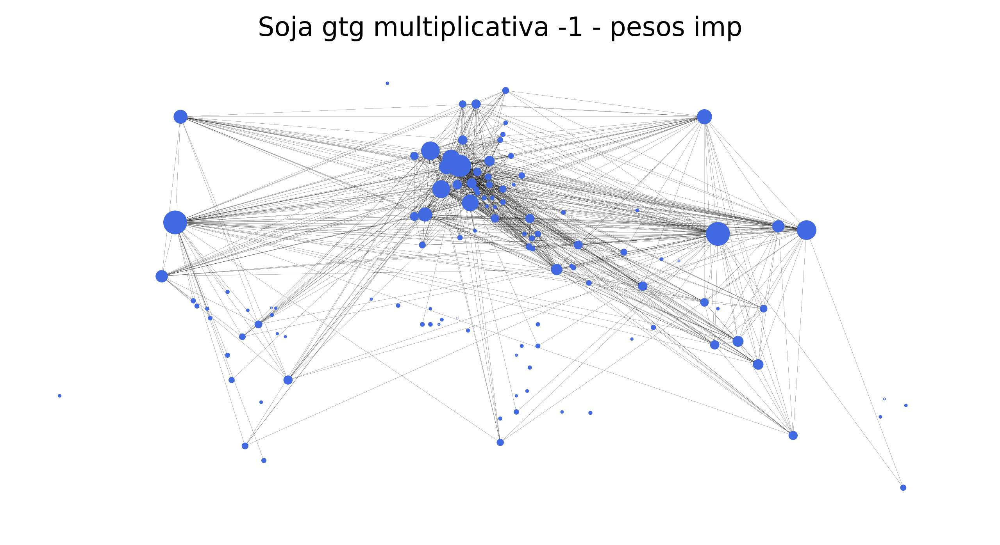

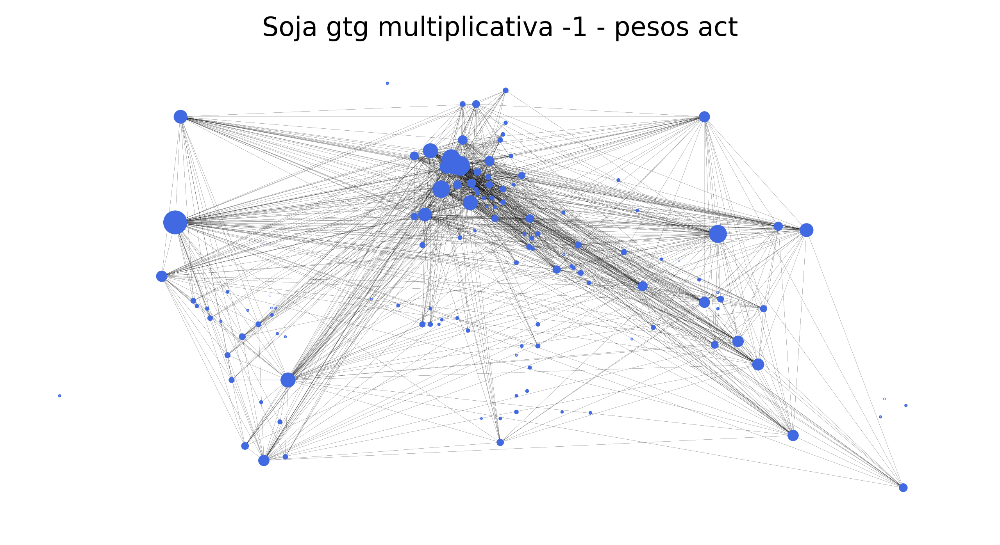

In [224]:
# Exportaciones totales add
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg1, ax=ax, show_labels=True)
ax.set_title('Soja gtg aditiva -1 - pesos exp')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_add_exp_-1_circ.svg'))

# Importaciones totales add
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg2, ax=ax, show_labels=True)
ax.set_title('Soja gtg aditiva -1 - pesos imp')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_add_imp_-1_circ.svg'))

# Actividad total add
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg3, ax=ax, show_labels=True)
ax.set_title('Soja gtg aditiva -1 - pesos act')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_add_act_-1_circ.svg'))

# Exportaciones totales mul
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg4, ax=ax, show_labels=False)
ax.set_title('Soja gtg multiplicativa -1 - pesos exp')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_mul_exp_-1_circ.svg'))

# Importaciones totales mul
fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg5, ax=ax, show_labels=False)
ax.set_title('Soja gtg multiplicativa -1 - pesos imp')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_mul_imp_-1_circ.svg'))

fig, ax = plt.subplots(dpi=400, figsize=(8, 4))
draw(gtg6, ax=ax, show_labels=False)
ax.set_title('Soja gtg multiplicativa -1 - pesos act')
plt.savefig(os.path.join(os.getcwd(), 'imagenes_redes', 'soja_gtg_mul_act_-1_circ.svg'))